<a href="https://colab.research.google.com/github/princesingh47/DEEP_LEARNING_PROJECT/blob/main/project_Coradatasheet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install torch_geometric

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 5.7 MB/s eta 0:00:00


In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch_geometric.datasets import Planetoid
import torch_geometric.transforms as T
from torch_geometric.nn import GCNConv

# Load the Cora dataset
dataset = Planetoid(root='/tmp/Cora', name='Cora', transform=T.NormalizeFeatures())

# Print dataset details
print(f'Dataset: {dataset.name}')
print(f'Number of graphs: {len(dataset)}')
print(f'Number of features: {dataset.num_features}')
print(f'Number of classes: {dataset.num_classes}')


Processing...
Done!


Dataset: Cora
Number of graphs: 1
Number of features: 1433
Number of classes: 7


In [3]:
"""
Cora is a well-known dataset commonly used for machine learning and information retrieval research, particularly in the domain of citation network analysis.
 Here is a detailed explanation of the Cora dataset:

Overview
The Cora dataset consists of scientific publications categorized into different classes, along with the citation relationships between them. Each publication is described by a set of words, and the primary task often associated with this dataset is node classification, where the goal is to predict the category of a paper based on its content and citation links.

Dataset Components
Nodes (Papers): Each node in the dataset represents a scientific paper. The total number of papers in the Cora dataset is 2,708.

Edges (Citations): The edges represent the citation links between the papers. If paper A cites paper B, there is a directed edge from A to B. There are 5,429 citation links in the dataset.

Features: Each paper is described by a binary word vector indicating the presence or absence of certain words from a predefined dictionary of 1,433 unique words. This results in a feature matrix of size 2708x1433.

Classes: Each paper belongs to one of 7 classes representing different research areas. The classes are:

Case Based
Genetic Algorithms
Neural Networks
Probabilistic Methods
Reinforcement Learning
Rule Learning
Theory
Applications
The Cora dataset is mainly used in the following types of research and applications:

Graph Neural Networks (GNNs): Since the dataset includes both node features and edge information, it is ideal for training and evaluating GNNs.

Node Classification: Researchers use the dataset to develop algorithms that predict the class of each paper based on its features and citation links.

Link Prediction: The dataset is also used to predict missing links in the citation network, i.e., determining if there should be a citation between two papers that are not currently connected.

Community Detection: Researchers use it to identify clusters or communities within the citation network.

Example Usage
Here’s a simple example of how the Cora dataset might be used in a GNN for node classification:

Preprocessing: Load the dataset, normalize the features, and split the data into training and test sets.

Model Training: Define a GNN model, such as Graph Convolutional Network (GCN), and train it on the training set using the node features and edges.

Evaluation: Evaluate the model’s performance on the test set by predicting the classes of the papers and comparing them to the true labels.

Importance in Research
The Cora dataset is significant in machine learning research due to its structured representation of textual data and citation links, making it an excellent benchmark for testing new algorithms in graph-based machine learning tasks.

Example Data Structure
The data can be represented in several formats, such as:

Adjacency List or Matrix: To represent the citation network.
Feature Matrix: To represent the word vectors of the papers.
Label Vector: To represent the class labels of the papers.
Summary
The Cora dataset is a rich source of information for researchers working on graph-based machine learning problems. It provides a well-structured citation network and textual data that can be leveraged for developing and benchmarking various machine learning algorithms, particularly in the field of network analysis and graph neural networks.
"""
import torch
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt

In [7]:

print(f'Graph: {dataset[0]}')

Graph: Data(x=[2708, 1433], edge_index=[2, 10556], y=[2708], train_mask=[2708], val_mask=[2708], test_mask=[2708])


In [19]:
data = dataset[0]
print(f'x = {data.x.shape}')
print(data.x)

x = torch.Size([2708, 1433])
tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]])


In [20]:
print(f'edge_index = {data.edge_index.shape}')
print(data.edge_index)
print(data.y)
print(data.train_mask)

edge_index = torch.Size([2, 10556])
tensor([[ 633, 1862, 2582,  ...,  598, 1473, 2706],
        [   0,    0,    0,  ..., 2707, 2707, 2707]])
tensor([3, 4, 4,  ..., 3, 3, 3])
tensor([ True,  True,  True,  ..., False, False, False])


In [21]:
from torch_geometric.utils import to_dense_adj

In [22]:
A = to_dense_adj(data.edge_index)[0].numpy().astype(int)
print(f'A = {A.shape}')
print(A)

A = (2708, 2708)
[[0 0 0 ... 0 0 0]
 [0 0 1 ... 0 0 0]
 [0 1 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 1]
 [0 0 0 ... 0 1 0]]


In [23]:
print(f'y = {data.y.shape}')
print(data.y)

y = torch.Size([2708])
tensor([3, 4, 4,  ..., 3, 3, 3])


In [24]:
print(f'train_mask = {data.train_mask.shape}')
print(data.train_mask)

train_mask = torch.Size([2708])
tensor([ True,  True,  True,  ..., False, False, False])


In [25]:
print(f'train_mask = {data.test_mask.shape}')
print(data.train_mask)

train_mask = torch.Size([2708])
tensor([ True,  True,  True,  ..., False, False, False])


In [26]:
print(f'train_mask = {data.val_mask.shape}')
print(data.train_mask)

train_mask = torch.Size([2708])
tensor([ True,  True,  True,  ..., False, False, False])


In [27]:
print(f'Edges are directed: {data.is_directed()}')
print(f'Graph has isolated nodes: {data.has_isolated_nodes()}')
print(f'Graph has loops: {data.has_self_loops()}')

Edges are directed: False
Graph has isolated nodes: False
Graph has loops: False


In [28]:
from torch_geometric.utils import to_networkx

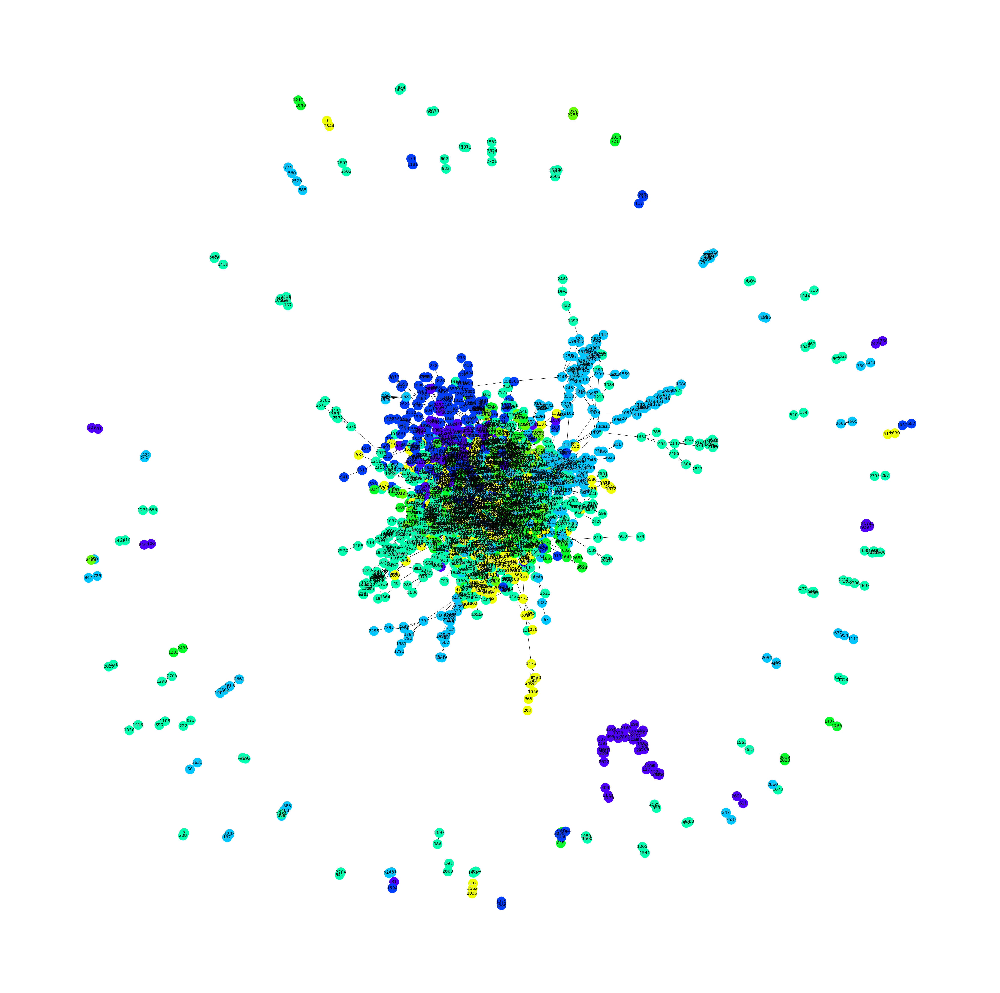

In [29]:
G = to_networkx(data, to_undirected=True)
plt.figure(figsize=(60,60))
plt.axis('off')
nx.draw_networkx(G,
                pos=nx.spring_layout(G, seed=0),
                with_labels=True,
                node_size=1000,
                node_color=data.y,
                cmap="hsv",
                vmin=-2,
                vmax=9,
                width=0.8,
                edge_color="black",
                font_size=14
                )
plt.show()

In [30]:
from torch.nn import Linear
from torch_geometric.nn import GCNConv

In [50]:
class GCN(torch.nn.Module):
    def __init__(self):
        super().__init__()
        self.gcn = GCNConv(dataset.num_features, 3)
        self.out = Linear(3, dataset.num_classes)
    def forward(self, x, edge_index):
        h = self.gcn(x, edge_index).relu()
        z = self.out(h)

        return h, z
model = GCN()
print(model)
"""
x: The input feature matrix, where each row corresponds to the features of a node.
edge_index: The edge indices defining the connections (edges) between nodes in the graph.
h = self.gcn(x, edge_index).relu():
self.gcn(x, edge_index): Applies the GCN convolution to the input features x using the graph structure defined by edge_index. This operation generates new node embeddings.
.relu(): Applies the ReLU activation function to the node embeddings to introduce non-linearity.
z = self.out(h): Applies the linear layer to the embeddings h to produce the final output z. This step maps the node embeddings to the number of classes.
return h, z: Returns both the intermediate node embeddings h and the final output z.
"""

GCN(
  (gcn): GCNConv(1433, 3)
  (out): Linear(in_features=3, out_features=7, bias=True)
)


'\nx: The input feature matrix, where each row corresponds to the features of a node.\nedge_index: The edge indices defining the connections (edges) between nodes in the graph.\nh = self.gcn(x, edge_index).relu():\nself.gcn(x, edge_index): Applies the GCN convolution to the input features x using the graph structure defined by edge_index. This operation generates new node embeddings.\n.relu(): Applies the ReLU activation function to the node embeddings to introduce non-linearity.\nz = self.out(h): Applies the linear layer to the embeddings h to produce the final output z. This step maps the node embeddings to the number of classes.\nreturn h, z: Returns both the intermediate node embeddings h and the final output z.\n'

In [51]:
criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.02)

Step-by-Step Breakdown:
Input Parameters:

data.x: Node features, typically represented as a tensor of shape [num_nodes, num_features].
data.edge_index: Graph connectivity information, often represented as a tensor of shape [2, num_edges] where 2 denotes the source and destination nodes for each edge.
GCN Layer (self.gcn):

self.gcn = GCNConv(num_features, 3): This initializes a Graph Convolutional Network (GCN) layer that takes num_features as input (number of features per node) and outputs 3 features per node after applying the convolutional operation.
When you call self.gcn(x, edge_index), internally the GCN layer applies its convolutional operation to x using the connectivity information provided by edge_index.
The output of self.gcn(x, edge_index) is stored in h.
ReLU Activation:

After receiving the output from self.gcn, relu() is applied to h using .relu(). This activation function helps introduce non-linearity and is a common choice after convolutional layers in neural networks.
Output Layer (self.out):

self.out = nn.Linear(3, num_classes): This initializes a linear layer (nn.Linear) that maps from the 3 features produced by the GCN layer (h) to num_classes output classes.
self.out(h) computes the linear transformation of h using the weights and biases defined in self.out.
The result of self.out(h) is stored in z.
Return Values:

h: Represents the output of the GCN layer after activation (relu), which is typically used as intermediate representations (node embeddings) in graph neural networks.
z: Represents the final output of the model after passing through the linear

In [57]:
# Calculate accuracy
def accuracy(pred_y, y):
    return (pred_y == y).sum() / len(y)
# Data for animations
embeddings = []
losses = []
accuracies = []
outputs = []
# Training loop
for epoch in range(5001):
    # Clear gradients
    optimizer.zero_grad()
    # Forward pass
    h, z = model(data.x, data.edge_index)

    # Calculate loss function
    loss = criterion(z, data.y)
    #print(loss)
    # Calculate accuracy
    acc = accuracy(z.argmax(dim=1), data.y)
    # Compute gradients
    loss.backward()
    # Tune parameters
    optimizer.step()
    # Store data for animations
    embeddings.append(h)
    losses.append(loss)
    accuracies.append(acc)
    outputs.append(z.argmax(dim=1))
    # Print metrics every 10 epochs
    if epoch % 10 == 0:
        print(f'Epoch {epoch:>3} | Loss: {loss:.2f} | Acc: {acc*100:.2f}%')
          # Print weights of the linear layer 'out'
    #    print('Weights of the linear layer "out":')
     #   print(model.out.weight)


Streaming output truncated to the last 5000 lines.
Epoch  10 | Loss: 0.50 | Acc: 83.90%
Weights of the linear layer "out":
Parameter containing:
tensor([[ 2.6496e-01, -1.6756e+01,  1.8352e-02],
        [ 5.2694e-02,  5.7279e+00,  3.2089e-01],
        [-2.2374e-02,  2.3502e+01, -7.5850e-02],
        [-3.9487e-01,  4.0251e+01,  1.6758e-01],
        [-1.8670e-01,  4.4749e+01, -1.7611e-01],
        [-4.8662e-01, -5.6764e+01, -6.1259e-01],
        [-5.0237e-01, -5.2443e+01,  9.2216e-02]], requires_grad=True)
Epoch  20 | Loss: 0.50 | Acc: 83.90%
Weights of the linear layer "out":
Parameter containing:
tensor([[ 2.6496e-01, -1.6766e+01,  1.8352e-02],
        [ 5.2694e-02,  5.7575e+00,  3.2089e-01],
        [-2.2374e-02,  2.3555e+01, -7.5850e-02],
        [-3.9487e-01,  4.0317e+01,  1.6758e-01],
        [-1.8670e-01,  4.4815e+01, -1.7611e-01],
        [-4.8662e-01, -5.6868e+01, -6.1259e-01],
        [-5.0237e-01, -5.2539e+01,  9.2216e-02]], requires_grad=True)
Epoch  30 | Loss: 0.50 | Acc: 83.

In [58]:
for i in range(2001):
  print(f"{100*losses[i].item():.2f}",end="    ")
print()
#%%capture
from IPython.display import HTML
from matplotlib import animation
plt.rcParams["animation.bitrate"] = 3000

49.80    49.79    49.79    49.80    49.79    49.79    49.79    49.79    49.78    49.79    49.79    49.78    49.79    49.78    49.78    49.77    49.78    49.78    49.77    49.79    49.78    49.78    49.77    49.77    49.78    49.78    49.77    49.76    49.77    49.76    49.77    49.76    49.76    49.76    49.75    49.75    49.75    49.74    49.75    49.74    49.74    49.74    49.74    49.74    49.74    49.73    49.73    49.73    49.73    49.73    49.73    49.72    49.73    49.72    49.72    49.72    49.72    49.72    49.72    49.72    49.72    49.72    49.72    49.73    49.72    49.72    49.71    49.72    49.71    49.71    49.72    49.70    49.71    49.70    49.70    49.71    49.70    49.71    49.70    49.70    49.69    49.69    49.69    49.68    49.69    49.69    49.68    49.70    49.69    49.69    49.69    49.68    49.68    49.68    49.68    49.67    49.67    49.67    49.67    49.66    49.66    49.66    49.66    49.66    49.66    49.65    49.66    49.66    49.65    49.67    49.69    4

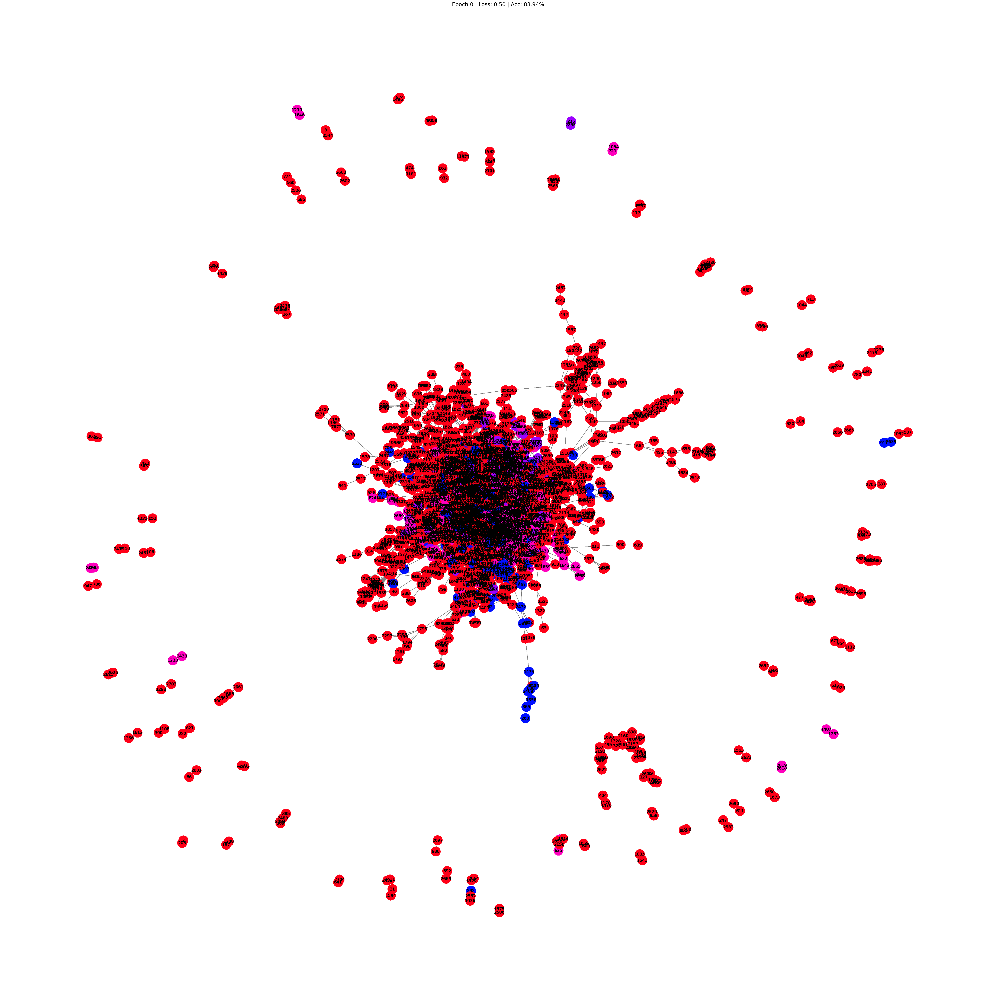

In [59]:
def animate(i):
    G = to_networkx(data, to_undirected=True)
    nx.draw_networkx(G,
                    pos=nx.spring_layout(G, seed=0),
                    with_labels=True,
                    node_size=1000,
                    node_color=outputs[i],
                    cmap="hsv",
                    vmin=-6,
                    vmax=3,
                    width=0.8,
                    edge_color="grey",
                    font_size=14
                    )
    plt.title(f'Epoch {i} | Loss: {losses[i]:.2f} | Acc: {accuracies[i]*100:.2f}%',
              fontsize=18, pad=20)
fig = plt.figure(figsize=(60, 60))
plt.axis('off')
anim = animation.FuncAnimation(fig, animate, \
            np.arange(0, 200, 10), interval=500, repeat=True)
html = HTML(anim.to_html5_video())
display(html)

In [ ]:
# Print embeddings
print(f'Final embeddings = {h.shape}')
print(h)

Final embeddings = torch.Size([2708, 3])
tensor([[1.2920, 0.0000, 0.3449],
        [1.4949, 0.0000, 1.2473],
        [1.4665, 0.0000, 0.7552],
        ...,
        [1.5949, 0.0000, 0.1433],
        [1.7213, 0.0000, 0.0000],
        [1.4691, 0.0000, 0.1801]], grad_fn=<ReluBackward0>)


In [ ]:
# Get first embedding at epoch = 0
embed = h.detach().cpu().numpy()
print(embed)

[[1.2919612  0.         0.34491333]
 [1.4948579  0.         1.2473128 ]
 [1.4664779  0.         0.7552299 ]
 ...
 [1.5948517  0.         0.14334007]
 [1.7213414  0.         0.        ]
 [1.4691411  0.         0.18006283]]


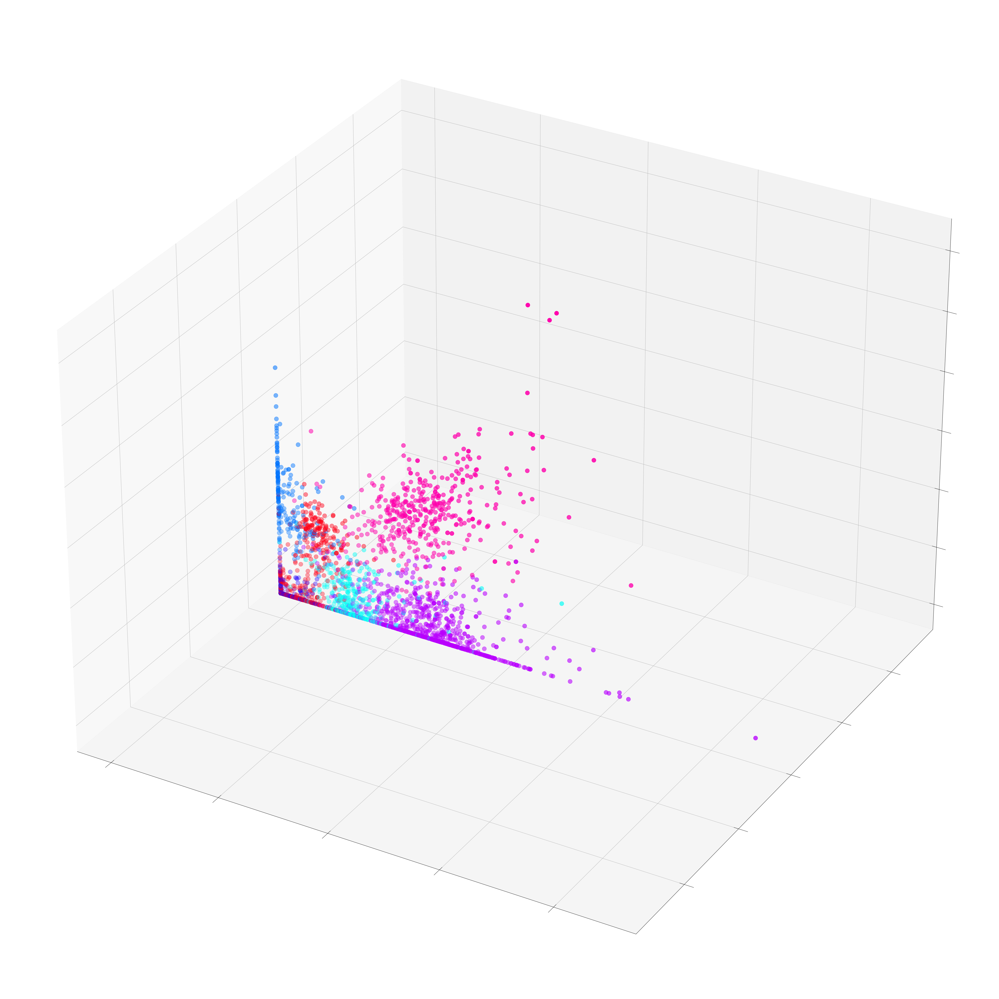

In [ ]:
fig = plt.figure(figsize=(60, 60))
ax = fig.add_subplot(projection='3d')
ax.patch.set_alpha(0)
plt.tick_params(left=False,
                bottom=False,
                labelleft=False,
                labelbottom=False)
ax.scatter(embed[:, 0], embed[:, 1], embed[:, 2],
           s=200, c=data.y, cmap="hsv", vmin=-5, vmax=5)
plt.show()

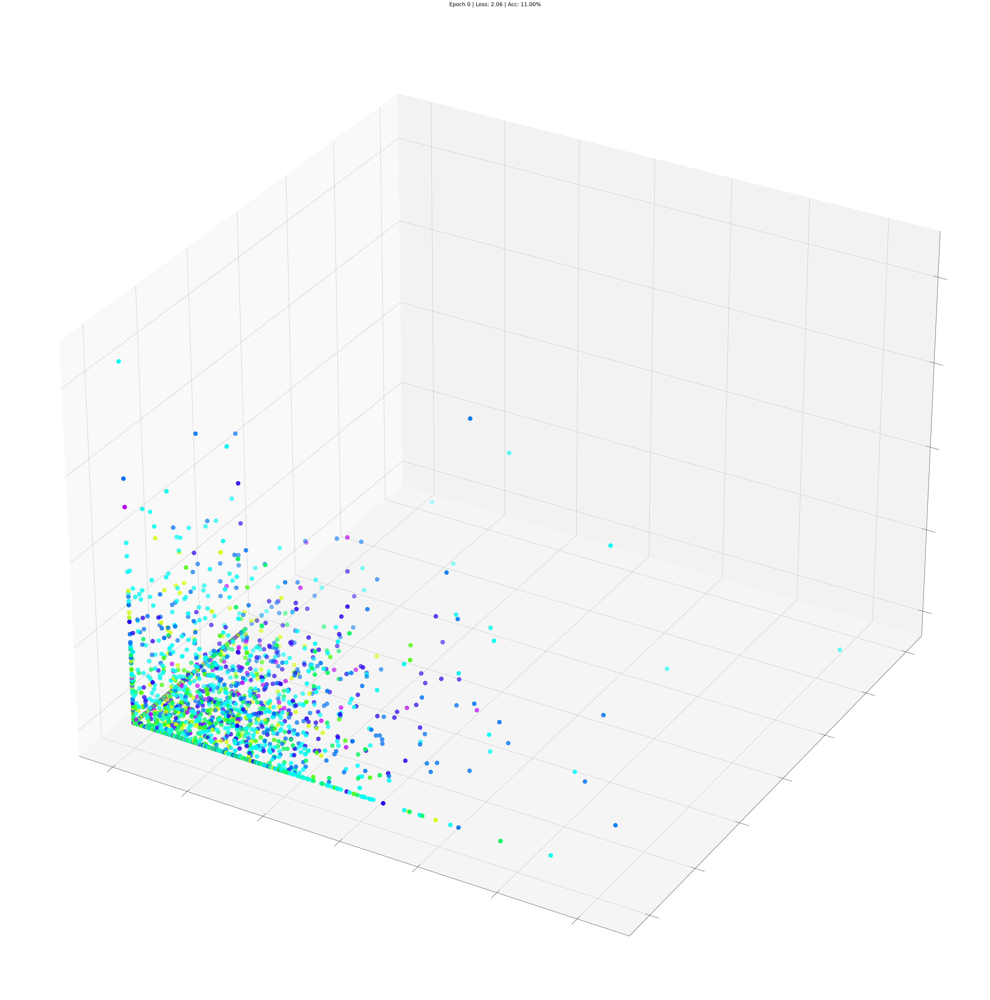

In [ ]:
def animate(i):
    embed = embeddings[i].detach().cpu().numpy()
    ax.clear()
    ax.scatter(embed[:, 0], embed[:, 1], embed[:, 2],
           s=200, c=data.y, cmap="hsv", vmin=-2, vmax=8)
    plt.title(f'Epoch {i} | Loss: {losses[i]:.2f} | Acc: {accuracies[i]*100:.2f}%',
              fontsize=18, pad=40)
fig = plt.figure(figsize=(60, 60))
plt.axis('off')
ax = fig.add_subplot(projection='3d')
plt.tick_params(left=False,
                bottom=False,
                labelleft=False,
                labelbottom=False)
anim = animation.FuncAnimation(fig, animate, \
              np.arange(0, 200, 10), interval=800, repeat=True)
html = HTML(anim.to_html5_video())
display(html)